In [1]:
from __future__ import print_function
import glob
import numpy as np
import pylab as pl
import sys
import pickle as pkl
from gatspy.periodic import LombScargleFast

import json
s = json.load( open("fbb_matplotlibrc.json") )
pl.rcParams.update(s)

%matplotlib nbagg
%pylab inline

REREAD=False
#REREAD=True
DETREND=0
nmax=150
lmax = 160

Populating the interactive namespace from numpy and matplotlib


/usr/local/lib/python2.7/dist-packages/matplotlib-1.4.3-py2.7-linux-x86_64.egg/matplotlib/__init__.py:855: UserWarning: svg.embed_char_paths is deprecated and replaced with svg.fonttype; please use the latter.
  warnings.warn(self.msg_depr % (key, alt_key))
/usr/local/lib/python2.7/dist-packages/IPython/kernel/__init__.py:13: ShimWarning: The `IPython.kernel` package has been deprecated. You should import from ipykernel or jupyter_client instead.
  "You should import from ipykernel or jupyter_client instead.", ShimWarning)


In [2]:
glob.glob("/home/fb55/UIdata/realdeal2/119.75*0000.raw")

['/home/fb55/UIdata/realdeal2/119.75hz_4hz_80ms_bridge.raw_2015-10-26-010131-0000.raw',
 '/home/fb55/UIdata/realdeal2/119.75hz_4hz_80ms_ESB.raw_2015-10-26-011644-0000.raw',
 '/home/fb55/UIdata/realdeal2/119.75hz_4hz_80ms_ESB2_2015-10-26-013201-0000.raw',
 '/home/fb55/UIdata/realdeal2/119.75hz_4hz_80ms_ESB2_2015-10-26-013159-0000.raw',
 '/home/fb55/UIdata/realdeal2/119.75hz_4hz_80ms_ESB2_2015-10-26-013420-0000.raw']

In [3]:
nrow = 2048
ncol = 2448
nband = 3

flist=glob.glob("/home/fb55/UIdata/realdeal2/119.75hz_4hz_80ms_ESB2_2015-10-26-013420-*.raw")
flist11975=np.array(flist)[np.argsort(flist)]
print(len(flist))


1000


In [4]:
def plotwindows(x1,y1,x2,y2, imfile, axs=None, c='w', plotimg=0):
    if axs == None:
        fig, axs = pl.subplots(1,1,figsize=(15,15))
    #pl.imshow(np.fromfile(flist[0],dtype=np.uint8).reshape(nrow,ncol,nband))
    #pl.imshow(np.fromfile(flist[0],dtype=np.uint8).reshape(nrow,ncol,nband)[x1:x2,y1:y2])
    #pl.figure()
    #axs.imshow(np.fromfile(flist[0],dtype=np.uint8).reshape(nrow,ncol,nband)[y1:y2,x1:x2],  interpolation='none')
    if plotimg == 0:
        axs.imshow(np.fromfile(imfile,dtype=np.uint8).reshape(nrow,ncol,nband),  interpolation='none')
        axs.set_xlim(0, axs.get_xlim()[1])
        axs.set_ylim(axs.get_ylim()[0], 0)
    axs.plot([x1,x2],[y1,y1], '-', color='%s'%c)    
    axs.plot([x2,x2],[y1,y2], '-', color='%s'%c)    
    axs.plot([x1,x2],[y2,y2], '-', color='%s'%c)    
    axs.plot([x1,x1],[y2,y1], '-', color='%s'%c)    
    #pl.show()
    

In [5]:
def read_to_lc(x1,y1,x2,y2, flist, fname, c='w', showme=False, verbose = False):
    if showme :
        plotwindows(x1,y1,x2,y2, flist[0], c=c)
    if REREAD: 
        a=np.zeros(len(flist[:nmax]))
        for i,f in enumerate(flist[:nmax]):
            try: a[i] = (np.fromfile(f,dtype=np.uint8).reshape(nrow,ncol,nband)[y1:y2,x1:x2].sum())
            except: 
                a[i]=float('NaN')
                continue
            #print (np.fromfile(f,dtype=np.uint8).reshape(nrow,ncol,nband)[y1:y2,x1:x2,0])
            #a[i] = (np.fromfile(f,dtype=np.uint8).reshape(nrow,ncol,nband)[y1:y2,x1:x2]).sum()
        
    else:
        a=pkl.load(open(fname+".pkl",'rb'))
    f0 = ((np.fromfile(flist[0],dtype=np.uint8).reshape(nrow,ncol,nband)[y1:y2,x1:x2]))
    area = (x2-x1)*(y2-y1)
    if verbose:
        print ('mean: {0:.2f}, stdev: {1:.2f}, area: {2:d} pixels, {3:d} images, average flux/pixel: {4:.1f}'.format(
                    np.nanmean(a), np.nanstd(a), area, len(a), np.nanmean(a)/float(area)))
    R = float(f0[:,:,0].sum())
    G = float(f0[:,:,1].sum())
    B = float(f0[:,:,2].sum())
    mx = np.argmax([R,G,B])
    colors= ['Red','Yellow','Blue']
    if verbose:
        print (colors[mx], ': R: {0:.2f} G: {1:.2f} B: {2:.2f}'.format(1, G/R, B/R))
    if REREAD: pkl.dump(a,open(fname+".pkl","wb"))
    return (a)


In [6]:

font = {'size'   : 23}
def get_plot_lca (x1, y1, x2, y2, flist, fname, c='w', verbose=True):
    a= read_to_lc(x1, y1, x2, y2, flist, fname, c=c, verbose=verbose)
    flux0=(a-np.nanmean(a))/np.nanstd(a)
    flux=flux0.copy()
    
    if verbose:
        pl.rc('font', **font)

        pl.figure(figsize=(15,5))
        pl.plot(flux, color=c)
        pl.xlabel("img number")
        pl.ylabel("standardized flux")
        pl.title("119hz_w2 shutter 4Hz camera sampling")
        pl.xlim(0,200)

    return flux0

In [7]:
allights = [[2087.109280, 1653.341270],
[2049.600122, 1597.077534],
[1999.587912, 1706.479243],
[1924.569597, 1756.491453],
[1905.815018, 1844.012821],
[1915.192308, 1690.850427],
[1777.658730, 1731.485348],
[1727.646520, 1603.329060],
[1762.029915, 1572.071429],
[1796.413309, 1550.191087],
[1743.275336, 1459.543956],
[1768.281441, 1468.921245],
[1671.382784, 1615.832112],
[1668.257021, 1665.844322],
[1646.376679, 1678.347375],
[1727.646520, 1740.862637],
[1765.155678, 1709.605006],
[2049.600122, 1381.399878],
[2055.851648, 1356.393773],
[2058.977411, 1325.136142],
[2165.253358, 1415.783272],
[2365.302198, 1300.130037],
[2365.302198, 1046.943223],
[2409.062882, 1096.955433],
[1971.456044, 1165.722222],
[2027.719780, 1128.213065],
[1915.192308, 1093.829670],
[1968.330281, 1050.068987],
[2024.594017, 1009.434066],
[2190.259463, 878.152015],
[2246.523199, 831.265568],
[2299.661172, 790.630647],
[2340.296093, 696.857753],
[2368.427961, 671.851648],
[2377.805250, 593.707570],
[2359.050672, 524.940781],
[2196.510989, 509.311966],
[2171.504884, 528.066545],
[2105.863858, 428.042125],
[2299.661172, 209.238706],
[2221.517094, 81.082418],
[1874.557387, 606.210623],
[1846.425519, 628.090965],
[1927.695360, 993.805250],
[1908.940781, 959.421856],
[1858.928571, 1028.188645],
[1727.646520, 1018.811355],
[1702.640415, 971.924908],
[1712.017705, 1006.308303],
[1608.867521, 978.176435],
[1565.106838, 987.553724],
[1521.346154, 950.044567],
[1871.431624, 606.210623],
[1846.425519, 624.965201],
[1605.741758, 765.624542],
[1583.861416, 740.618437],
[1602.615995, 728.115385],
[1715.143468, 559.324176],
[1762.029915, 587.456044],
[1615.119048, 565.575702],
[1590.112943, 478.054335],
[2043.348596, 378.02991],
[987.540000, 924.300000],
[590.740000, 700.300000],
[625.940000, 962.700000],
[670.740000, 889.100000],
[648.340000, 911.500000],
[1381.140000, 1173.900000],
[1422.740000, 1186.700000],
[1461.140000, 1237.900000],
[1537.940000, 1218.700000],
[1515.540000, 1372.300000],
[1643.540000, 1356.300000],
[1445.140000, 1445.900000],
[1473.940000, 1484.300000],
[1441.940000, 1506.700000],
[1061.140000, 1737.100000],
[1086.740000, 1772.300000],
[990.740000, 1791.500000],
[1016.340000, 1833.100000],
[920.340000, 1829.900000],
[923.540000, 1810.700000],
[968.340000, 1884.300000],
[869.140000, 1983.500000],
[782.740000, 1897.100000],
[417.940000, 1999.500000],
[309.140000, 1551.500000],
[936.340000, 1705.100000],
[945.940000, 1698.700000],
[965.140000, 1682.700000],
[910.740000, 1538.700000],
[821.140000, 1765.900000],
[821.140000, 1775.500000],
[805.140000, 1781.900000],
[789.140000, 1753.100000],
[773.140000, 1785.100000],
[808.340000, 1769.100000],
[840.340000, 1769.100000],
[757.140000, 1621.900000],
[798.740000, 1580.300000],
[785.940000, 1487.500000],
[696.340000, 1545.100000],
[664.340000, 1647.500000],
[673.940000, 1641.100000],
[664.340000, 1631.500000],
[654.740000, 1621.900000],
[664.340000, 1602.700000],
[670.740000, 1609.100000],
[696.340000, 1545.100000],
[545.940000, 1586.700000],
[737.940000, 1522.700000],
[785.940000, 1490.700000],
[718.740000, 1445.900000],
[827.540000, 1362.700000],
[705.940000, 1282.700000],
[686.740000, 1260.300000],
[686.740000, 1292.300000],
[1800.340000, 2037.900000],
[1854.740000, 2018.700000],
[1857.940000, 1983.500000],
[2293.140000, 1724.300000],
[2293.140000, 1708.300000],
[2174.740000, 815.500000],
[2097.940000, 1743.500000],
[1431.245410, 85.042228],
[1468.846389, 138.310282],
[1481.380049, 153.977356],
[1493.913709, 169.644431],
[1506.447368, 191.578335],
[1518.981028, 207.245410],
[1537.781518, 229.179315],
[1540.914933, 285.580783],
[1578.515912, 269.913709],
[1578.515912, 254.246634],
[1622.383721, 298.114443],
[1609.850061, 310.648103],
[1581.649327, 329.448592],
[1572.249082, 341.982252],
[1644.317625, 285.580783],
[1772.787638, 244.846389],
[1722.652999, 222.912485],
[1703.852509, 197.845165],
[1782.187882, 351.382497],
[1757.120563, 360.782742],
[1747.720318, 376.449816],
[1920.058140, 238.579559],
[1891.857405, 257.380049],
[1948.258874, 282.447368],
[1550.315177, 586.388617],
[1522.114443, 602.055692],
[1506.447368, 614.589351],
[1475.113219, 564.454712],
[1462.579559, 548.787638],
[1450.045900, 536.253978],
[1224.440024, 752.459608],
[1283.974908, 846.462056],
[1221.306610, 808.861077],
[1271.441248, 774.393513],
[1221.306610, 724.258874],
[1591.049572, 492.386169]]

kelly_colors_hex = [
    '#FFB300', # Vivid Yellow
    '#803E75', # Strong Purple
    '#FF6800', # Vivid Orange
    '#A6BDD7', # Very Light Blue
    '#C10020', # Vivid Red
    '#CEA262', # Grayish Yellow
    '#817066', # Medium Gray
    '#007D34', # Vivid Green
    '#F6768E', # Strong Purplish Pink
    '#00538A', # Strong Blue
    '#FF7A5C', # Strong Yellowish Pink
    '#53377A', # Strong Violet
    '#FF8E00', # Vivid Orange Yellow
    '#B32851', # Strong Purplish Red
    '#F4C800', # Vivid Greenish Yellow
    '#7F180D', # Strong Reddish Brown
    '#93AA00', # Vivid Yellowish Green
    '#593315', # Deep Yellowish Brown
    '#F13A13', # Vivid Reddish Orange
    '#232C16', # Dark Olive Green
    ]


In [8]:
def sparklines(data, lab, ax, x=None):
    if x==None :#and len(x)==0:
        x=np.arange(len(data)) 
    ax.plot(x, data, 'k', alpha=0.3)
    ax.axis('off')
    ax.set_xlim(-(x.max()-x.min())*0.1, (x.max()-x.min())*1.1)
    try:
        ax.plot(x[np.where(data == max(data))[0]], max(data), 'o', ms=15)
    except ValueError:
        try:
            ax.plot(x[np.where(data == max(data))[0][0]], max(data), 'o', ms=15)
        except IndexError: pass
    try:
        ax.plot(x[np.where(data == min(data))[0]], min(data), 'o', ms=15)
    except ValueError:
        try:
            ax.plot(x[np.where(data == min(data))[0][0]], min(data), 'o', ms=15)
        except IndexError: pass
    ax.set_ylim(ax.get_ylim()[0]-(ax.get_ylim()[1]-ax.get_ylim()[0])/10, ax.get_ylim()[1])
    ax.text(1., 0.5, "%.1f"%(min(data)), fontsize = 25, 
           transform = ax.transAxes, color='IndianRed')
    ax.text(1.1, 0.5, "%.1f"%(max(data)), fontsize = 25, 
               transform = ax.transAxes, color='SteelBlue')
    ax.text(-0.1, 0.95, lab, fontsize = 25, 
               transform = ax.transAxes)
    if title:
        ax.plot((0,ax.get_xlim()[1]), 
           (ax.get_ylim()[1], ax.get_ylim()[1]), 'k-',)



/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:5: RuntimeWarning: invalid value encountered in divide


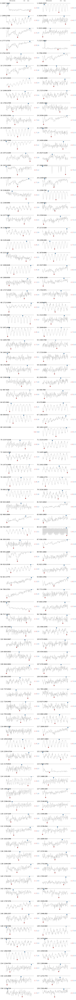

In [9]:
fname = 'ESB_119.75_camera4_50ms'

fig = pl.figure(figsize = (20,300))
ax = []
bs = np.zeros((lmax, nmax))
badindx = []
for i,cc in enumerate(allights[:lmax]):
    x2 = 0 if i%2 == 0 else 2
    #ax.append(pl.subplot2grid((25,3), ((i/2)+1, x2+1)))
    ax.append(fig.add_subplot(lmax/2+1,2,i+1))
    #if False:    
    bs[i] = get_plot_lca (int(cc[0])-1, int(cc[1])-1, 
                                       int(cc[0])+2, int(cc[1])+2,
                                           flist11975, 
                    fname+'_x%d_y%d'%(int(cc[0]), int(cc[1])), verbose=False)
    
    #pl.plot(b1)
    sparklines(bs[i], '%d %d:%d'%(i, int(cc[0]), int(cc[1])), ax[i])
    
    sample_rate = 0.25

    
    #ax[i].plot(np.arange(0, n*sample_rate, sample_rate), b1, 'IndianRed')
    #ax[i].set_xlabel("seconds")
    #ax[i].set_ylabel("standardized flux")
    #pl.title("ESB 11975hz shutter 4Hz camera sampling")

ax[0].text (0.2, 1.2, '{0:1d} seconds                             {1:2s}       {2:2s}'.format(len(bs[0])*4,'min','max'), 
            transform = ax[0].transAxes, fontsize=15)


ax[1].text (0.2, 1.2, '{0:1d} seconds                             {1:2s}       {2:2s}'.format(len(bs[0])*4,'min','max'), 
            transform = ax[1].transAxes, fontsize=15)

In [10]:
from images2gif import writeGif
import Image
import IPython.display as IPdisplay

def callplotw(xc, yc, i, fname = None, len=40):
    fig = pl.figure(figsize=(20,20))
    ax1 = fig.add_subplot(121)
    plotwindows(xc-25, yc-25, xc+25, yc+25, flist11975[10], axs=ax1, c='w', plotimg = 0)
    ax2 = fig.add_subplot(122)
    
    plotwindows(xc-25, yc-25, xc+25, yc+25, flist11975[nmax-10], axs=ax2, c='w', plotimg = 0)
    if fname: 
        images = [Image.fromarray(np.fromfile(f,
                              dtype=np.uint8).reshape(nrow,
                                                      ncol, nband)[yc-50:yc+52,
                                                                   xc-50:xc+52]) \
                  for f in flist11975[:len]]
        
        writeGif(fname + "_%04d_%04d"%(xc,yc)+".GIF", images, duration=0.01)
        
    fig = pl.figure(figsize=(20,2))
    ax3 = fig.add_subplot(121)
    ax3.plot(bs[i], label = "time series")
    ax3.legend()

    ax4 = fig.add_subplot(122)
    ax4.plot(np.fft.rfftfreq(nmax, d=sample_rate)[2:], np.abs(np.fft.rfft(bs[i]))[2:], 
             label = "fft")
    ax4.plot([0.23, 0.23], [ax4.get_ylim()[0], ax4.get_ylim()[1]])
    ax4.legend()

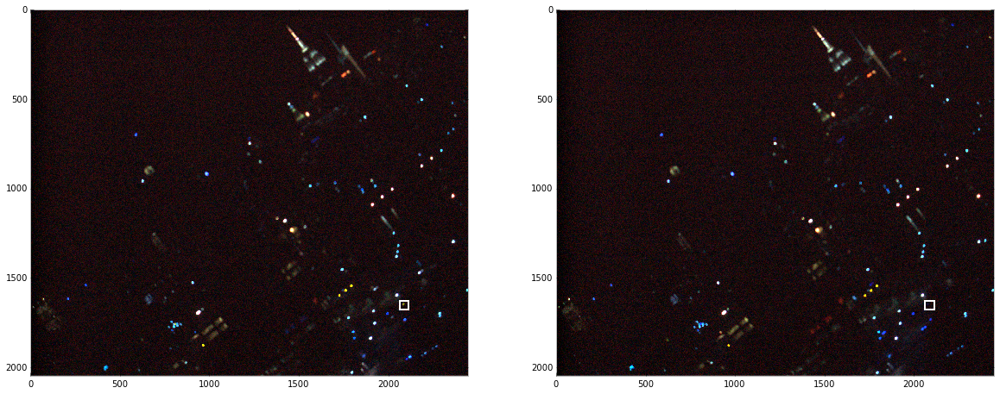

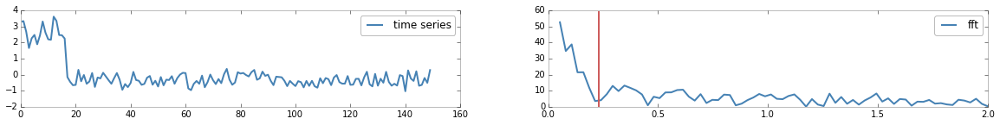

In [11]:
callplotw(2087, 1653, 0, fname = 'ESB_119.75_camera4_50ms', len=100)
IPdisplay.Image(url=fname + "_%d_%d"%(2087, 1653)+".GIF")

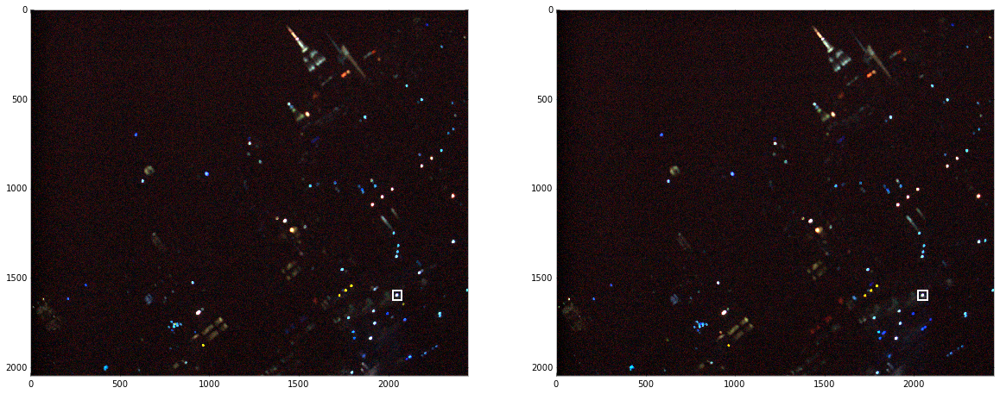

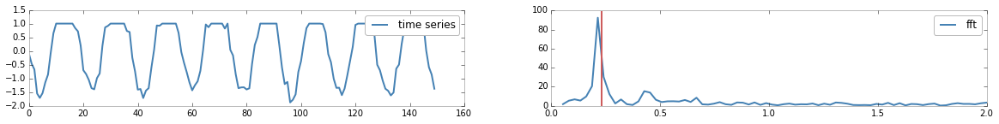

In [12]:
callplotw(2049, 1597, 1, fname = 'ESB_119.75_camera4_50ms')
IPdisplay.Image(url=fname + "_%d_%d"%(2049, 1597)+".GIF")

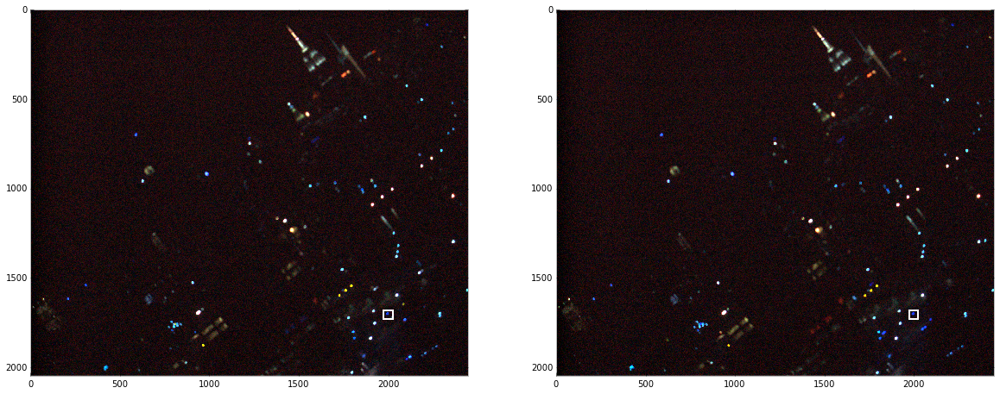

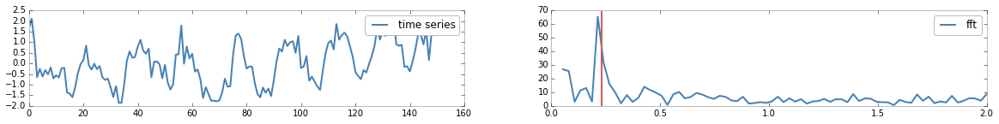

In [13]:
callplotw(1999, 1706, 2, fname = 'ESB_119.75_camera4_50ms')
IPdisplay.Image(url=fname + "_%d_%d"%(1999, 1706)+".GIF")

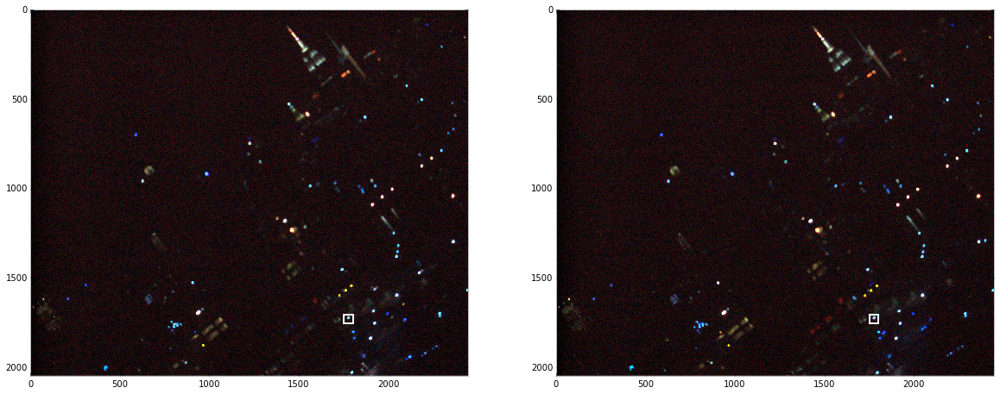

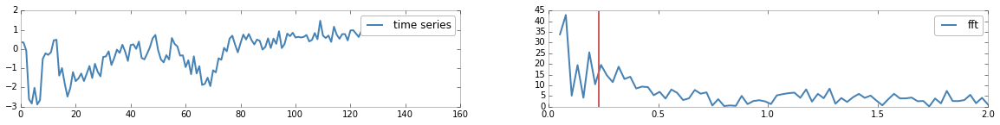

In [14]:
callplotw(1777, 1731, 6, fname = 'ESB_119.75_camera4_50ms', len=100)
IPdisplay.Image(url=fname + "_%d_%d"%(1777, 1731)+".GIF")

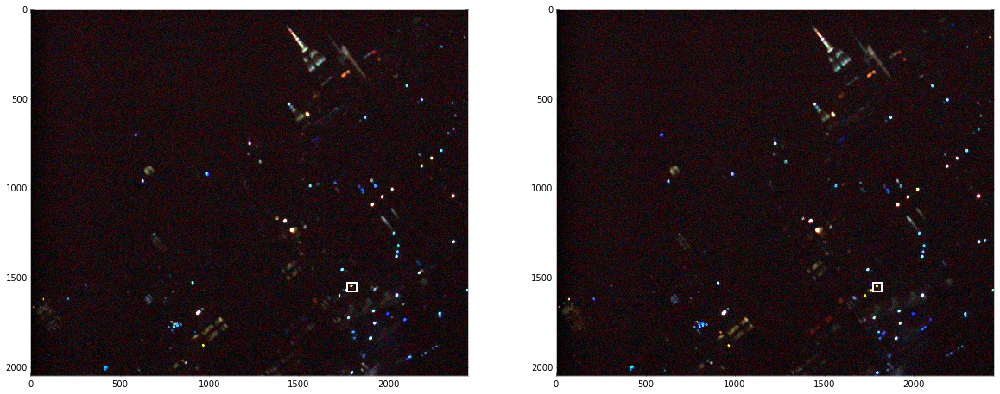

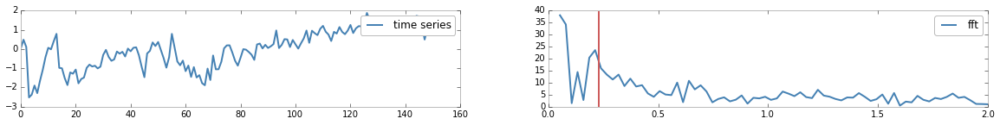

In [15]:
callplotw(1796, 1550, 9, fname = 'ESB_119.75_camera4_50ms', len=100)
IPdisplay.Image(url=fname + "_%d_%d"%(1796, 1550)+".GIF")

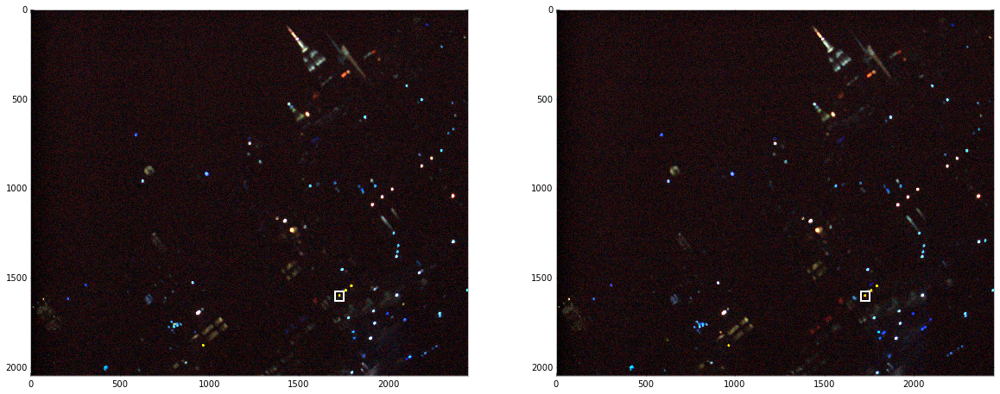

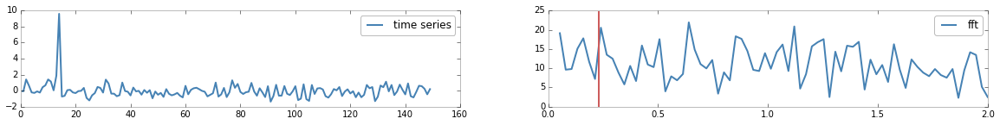

In [16]:
callplotw(1727, 1603, 7, fname = 'ESB_119.75_camera4_50ms', len=100)
IPdisplay.Image(url=fname + "_%d_%d"%(1727, 1603)+".GIF")

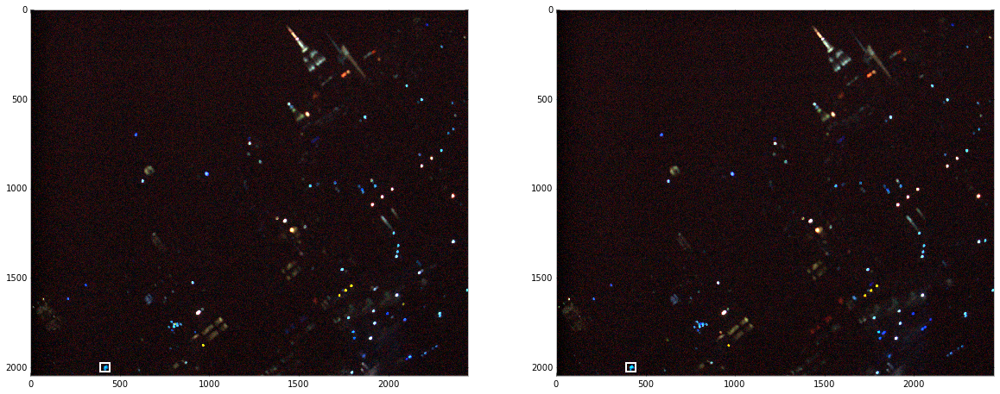

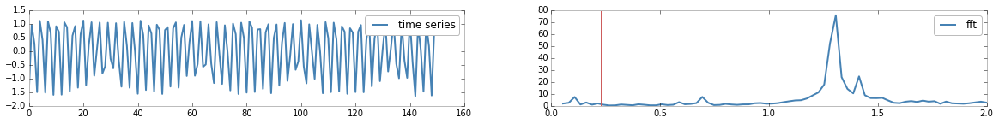

In [17]:
callplotw(417, 1999, 85, fname = 'ESB_119.75_camera4_50ms', len=100)
IPdisplay.Image(url=fname + "_%04d_%d"%(417, 1999)+".GIF")

In [ ]:
from sklearn.datasets import load_iris
from sklearn.decomposition import PCA
badindx = []
for i,bsi in enumerate(bs):
    if np.isnan(bsi).any():
        
        badindx.append(i)
bsnew = np.delete(bs, badindx, 0)

In [53]:
alllightsnew = np.delete(allights[:lmax],  badindx, 0)

[ 0.14435375  0.2779516   0.39243787  0.42762135  0.45719117  0.47563759
  0.4926113   0.508124    0.52333339  0.53795157  0.55167965  0.56526459
  0.57865601  0.59138872  0.60385122  0.61580702  0.62724224  0.63833434
  0.64916414  0.6598829   0.67038365  0.68061245  0.69073029  0.70052053
  0.70993329  0.71900728  0.72794485  0.73676698  0.74509897  0.75328448
  0.76127497  0.76911296  0.77664023  0.78394213  0.79107495  0.79805066
  0.80495104  0.81154472  0.81794239  0.82415695  0.83020569  0.83602398
  0.84162789  0.84718988  0.85261742  0.85791265  0.86315134  0.86814823
  0.87297851  0.87763811  0.88219874  0.88662775  0.89085428  0.89492483
  0.8988725   0.90270463  0.90643618  0.90998867  0.91344935  0.91686817
  0.92021432  0.92350152  0.9267255   0.92983509  0.93277372  0.935668
  0.93847671  0.94119154  0.94382175  0.94633442  0.94875544  0.95104466
  0.95328497  0.95543624  0.95752038  0.95952745  0.96142967  0.9632577
  0.96496818  0.96658473  0.96816445  0.96971794  0.97

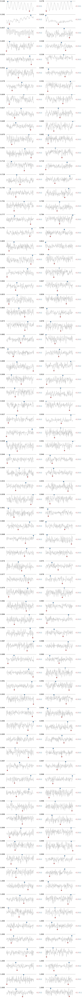

In [19]:
bs = bsnew
fig = pl.figure(figsize = (20,300))
ax = []


pca = PCA()
X_pca = pca.fit_transform(bs)
pca.fit(bs)

evals = pca.explained_variance_ratio_
print (evals.cumsum())
evals_cs = evals.cumsum()

#  because the spectra have been reconstructed from masked values, this
#  is not exactly correct in this case: we'll use the values computed
#  in the file compute_sdss_pca.py
#evals = data['evals'] ** 2
#evals_cs = evals.cumsum()
#evals_cs /= evals_cs[-1]
#evecs=data['evecs']

evecs = pca.components_

for i,Xc in enumerate(evecs):
    if evals_cs[i] > 91:
        break
    x2 = 0 if i%2 == 0 else 2
    #ax.append(pl.subplot2grid((25,3), ((i/2)+1, x2+1)))
    ax.append(fig.add_subplot(lmax/2+1,2,i+1))
    #if False:    
    #pl.plot(b1)
    sparklines(Xc, "%.3f"%evals_cs[i], ax[i])
    
    #sample_rate = 0.25

    #ax[i].plot(np.arange(0, n*sample_rate, sample_rate), b1, 'IndianRed')
    #ax[i].set_xlabel("seconds")
    #ax[i].set_ylabel("standardized flux")
    #pl.title("ESB 11975hz shutter 4Hz camera sampling")



/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:2: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.
  from ipykernel import kernelapp as app


array([9, 7, 3, 8, 0, 8, 0, 9, 8, 0, 0, 6, 0, 3, 3, 7, 8, 5, 6, 0, 3, 9, 1,
       9, 8, 8, 6, 5, 0, 0, 5, 7, 4, 6, 6, 0, 1, 1, 2, 4, 5, 1, 1, 0, 8, 0,
       6, 8, 1, 4, 4, 2, 1, 1, 8, 8, 6, 8, 8, 0, 8, 0, 2, 3, 2, 7, 7, 0, 7,
       3, 3, 7, 4, 4, 7, 4, 7, 4, 8, 0, 0, 0, 4, 6, 8, 0, 0, 0, 1, 8, 0, 0,
       0, 0, 9, 0, 4, 9, 5, 4, 0, 0, 9, 8, 0, 8, 4, 0, 8, 9, 2, 3, 3, 4, 8,
       0, 4, 4, 3, 3, 8, 9, 8, 8, 0, 0, 8, 8, 6, 8, 0, 6, 0, 0, 6, 0, 0, 8,
       6, 8, 6, 9, 2, 6, 4, 0, 7, 2, 3, 7, 1, 3, 8, 0, 6, 6, 2, 0], dtype=int32)

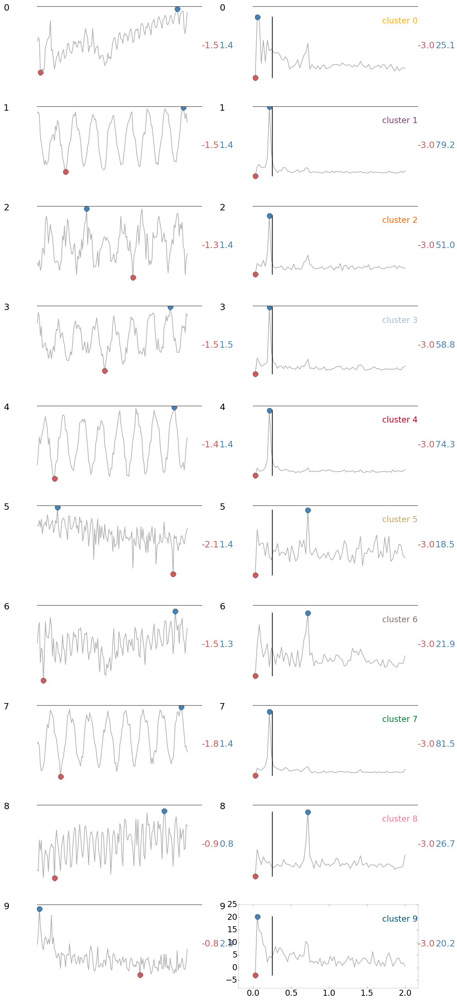

In [24]:
from sklearn.cluster import KMeans

km = KMeans(n_clusters=10)


vals = ((bs.T - bs.mean(1))/bs.std(1)).T

km.fit(vals)
km.cluster_centers_
km.labels_
fig = pl.figure(figsize=(20,100))
ax = []
freq = np.fft.rfftfreq(nmax, d=sample_rate)
for i,Xc in enumerate(km.cluster_centers_):
    ax.append(fig.add_subplot(20,2,(i*2+1)))
    #if False:    
    #pl.plot(b1)
    sparklines(Xc, "%i"%(i), ax[-1])
    ax.append(fig.add_subplot(20,2,(i*2+2)))
    fft = np.abs(np.fft.rfft(Xc))[1:]
    fft[0]=-3
    sparklines(fft, "%i"%(i), ax[-1], x=freq[1:])
    ax[-1].plot([0.25,0.25],[fft.min(),fft.max()],'k-')
    ax[-1].text(0.8,0.8,"cluster %i"%i,color=kelly_colors_hex[i], transform=ax[-1].transAxes)
    #ax[i].plot(freq, np.abs(np.fft.rfft(Xc)), alpha=0.5, color='IndianRed')
ax[-1].axis("on")
km.labels_


(2048, 2448, 3)


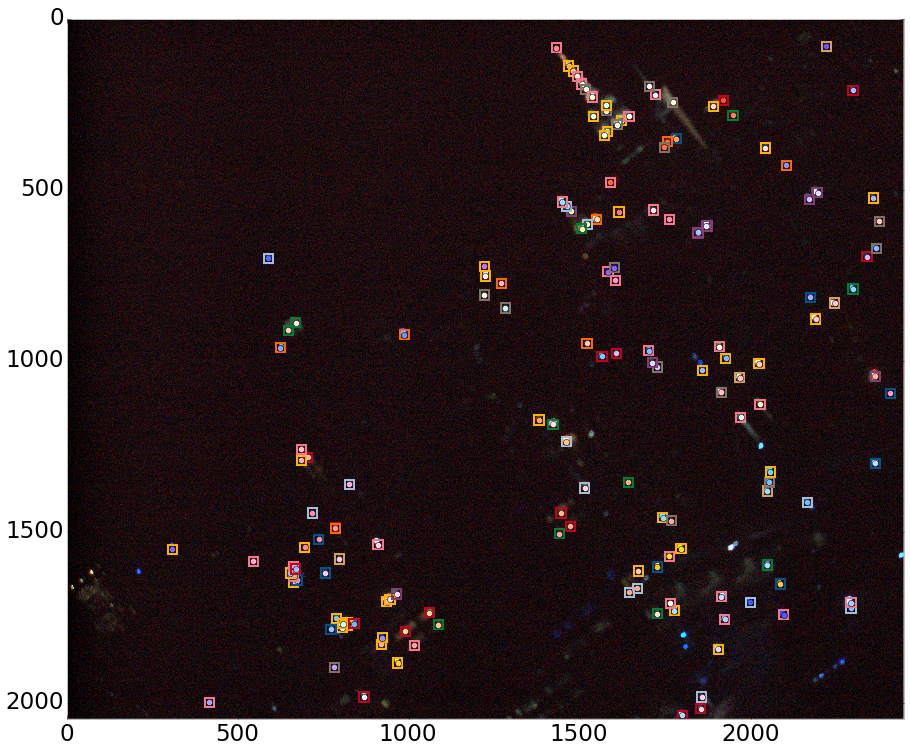

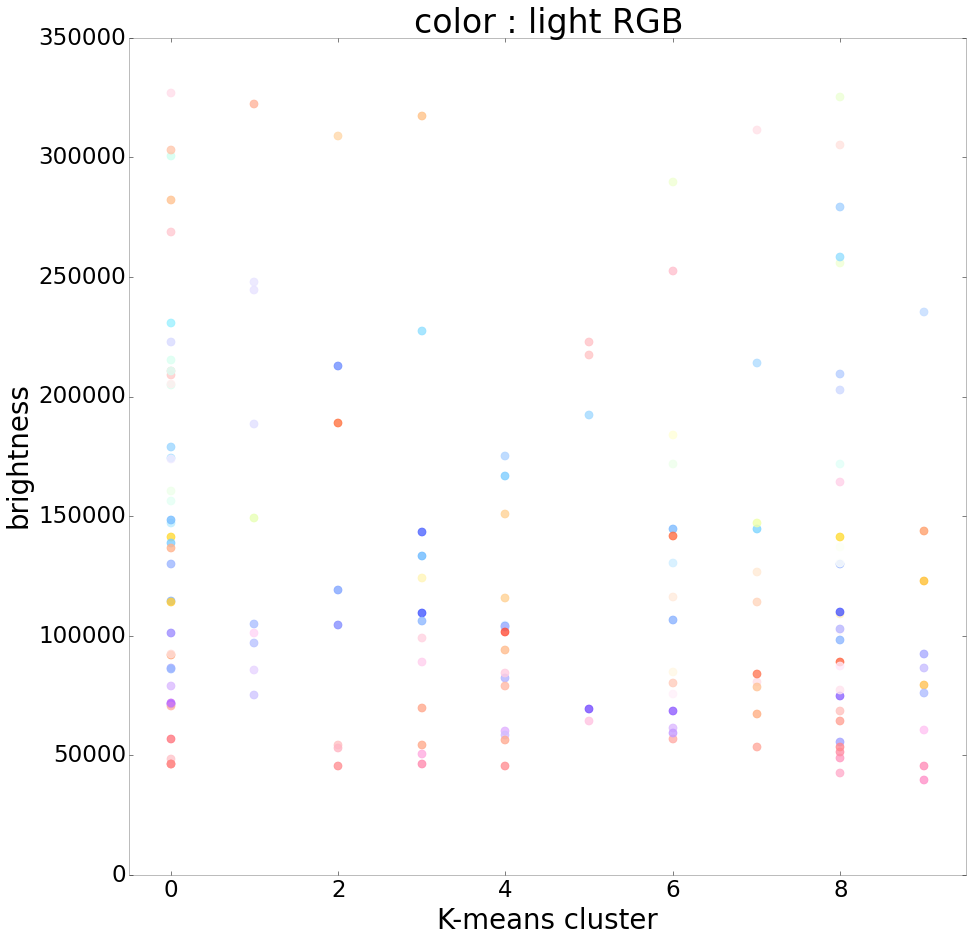

In [25]:

font = {'size'   : 23}
pl.rc('font', **font)

for i in badindx:
    allights2=np.delete(allights, i, 0)
for i in badindx:
    allights2=np.delete(allights, i, 0)
fig = figure(figsize=(15,15))
axs = fig.add_subplot(111)
#import matplotlib.image as mpimg
#img=mpimg.imread('ESBstack.png')
#img = np.sum(np.array([np.fromfile(flist11975[i],dtype=np.uint8).reshape(nrow,ncol,nband) for i in range(1)]), axis=0)
img = np.fromfile(flist11975[0],dtype=np.uint8).reshape(nrow,ncol,nband)
print (img.shape)
axs.imshow(img,  interpolation='none')
axs.set_xlim(0, axs.get_xlim()[1])
axs.set_ylim(axs.get_ylim()[0], 0)
fig2 = figure(figsize=(15,15))
axs2 = fig2.add_subplot(111)

for i,cc in enumerate(allights2[:lmax-len(badindx)]):
    x1,x2=int(cc[0])-13,int(cc[0])+14
    y1,y2=int(cc[1])-13, int(cc[1])+14
    axs.plot([x1,x2],[y1,y1], '-', color='%s'%kelly_colors_hex[km.labels_[i]])    
    axs.plot([x2,x2],[y1,y2], '-', color='%s'%kelly_colors_hex[km.labels_[i]])    
    axs.plot([x1,x2],[y2,y2], '-', color='%s'%kelly_colors_hex[km.labels_[i]])    
    axs.plot([x1,x1],[y2,y1], '-', color='%s'%kelly_colors_hex[km.labels_[i]])  
    R = sum(img[y1:y2,x1:x2,0].astype(float))
    G = sum(img[y1:y2,x1:x2,1].astype(float))
    B = sum(img[y1:y2,x1:x2,2].astype(float))
    norm = max([R,G,B])
    axs.plot(int(cc[0]),int(cc[1]), 'o', color=(R/norm, G/norm, B/norm))    
    
    #print (km.labels_[i], '{0:.2f} {1:.2f} {2:.2f}'.format(R/norm, G/norm, B/norm))
    axs2.scatter(km.labels_[i], sum(img[y1:y2,x1:x2,:]), s=60, 
                 color = (R/norm, G/norm, B/norm), alpha=0.8)  
axs2.set_xlim(-0.5,9.5)
axs2.set_xlabel("K-means cluster")
axs2.set_ylabel("brightness")
axs2.set_title("color : light RGB")

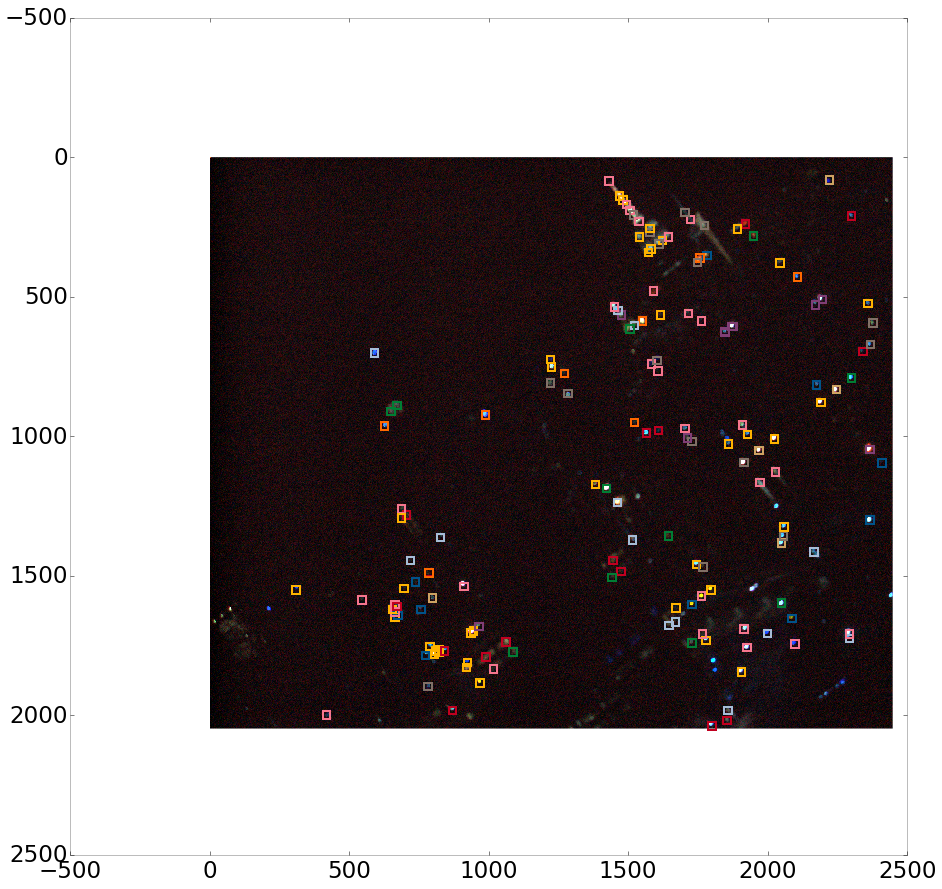

In [26]:
for i in badindx:
    allights2=np.delete(allights, i, 0)
for i in badindx:
    allights2=np.delete(allights, i, 0)
fig=figure(figsize=(15,15))
axs = fig.add_subplot(111)
axs.imshow(np.fromfile(flist11975[0],dtype=np.uint8).reshape(nrow,ncol,nband),  interpolation='none')

for i,cc in enumerate(allights2[:lmax-len(badindx)]):
    x1,x2=int(cc[0])-13,int(cc[0])+14
    y1,y2=int(cc[1])-13, int(cc[1])+14
    axs.plot([x1,x2],[y1,y1], '-', color='%s'%kelly_colors_hex[km.labels_[i]])    
    axs.plot([x2,x2],[y1,y2], '-', color='%s'%kelly_colors_hex[km.labels_[i]])    
    axs.plot([x1,x2],[y2,y2], '-', color='%s'%kelly_colors_hex[km.labels_[i]])    
    axs.plot([x1,x1],[y2,y1], '-', color='%s'%kelly_colors_hex[km.labels_[i]])    


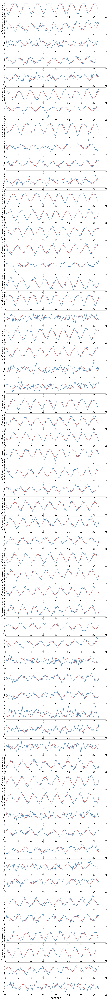

In [87]:
phi0 = 0
wfreq = 0.22
import scipy.optimize

wave = lambda t, phi: np.sin(2.*wfreq*np.pi*t+phi)
resd = lambda phi, x, t: np.sum((wave(t*0.25, phi) - x)**2)
ntot = 0
for i in [1,2,3,4,7]: 
    ntot += sum(km.labels_ == i)

fig = pl.figure(figsize=(20,200))
j = 0
phases = np.zeros((4,len(bs)))*float('NaN')
for i,Xc in enumerate(bs):
    if km.labels_[i] in [1,2,3,4,7]:
        j = j+1
        ax.append(fig.add_subplot(ntot+1,1,(j+1)))
        fits = scipy.optimize.minimize(resd, phi0, 
                                       args=((Xc-Xc.mean())/Xc.std(), np.arange(len(Xc))))
        #print ( fits )
        phases[0][i] = fits.x%(2*np.pi)
        phases[1][i] = km.labels_[i]
        phases[2][i] = alllightsnew[i][0]
        phases[3][i] = alllightsnew[i][1]
        ax[-1].plot(np.arange(len(Xc))*0.25,(Xc-Xc.mean())/Xc.std())
        ax[-1].plot(np.arange(len(Xc))*0.25,wave(np.arange(len(Xc))*0.25, phases[0][i]))
        ax[-1].set_xlabel("seconds")

In [88]:
phases[0]

array([        nan,  2.91457621,  0.14579896,         nan,         nan,
               nan,         nan,         nan,         nan,         nan,
               nan,         nan,         nan,  0.39071849,  0.42563129,
        2.51855602,         nan,         nan,         nan,         nan,
        0.34723003,         nan,  0.90545974,         nan,         nan,
               nan,         nan,         nan,         nan,         nan,
               nan,  2.64316369,  5.10386944,         nan,         nan,
               nan,  1.19213626,  1.43739221,  3.5787076 ,  5.44924142,
               nan,  1.36623519,  1.34815665,         nan,         nan,
               nan,         nan,         nan,  0.90393165,  5.01962415,
        5.53543103,  4.39769917,  1.33527346,  1.32160604,         nan,
               nan,         nan,         nan,         nan,         nan,
               nan,         nan,  3.50417809,  0.86296056,  3.64210951,
        3.191049  ,  3.14076926,         nan,  2.64301674,  0.59

1.0
2.0
3.0
4.0
7.0
58 58 [[  1.00000000e+00   1.22464680e-16   6.12323400e-17   1.00000000e+00]
 [  2.09803922e-01   4.40215741e-01   9.74138602e-01   1.00000000e+00]
 [  2.84313725e-01   9.43154434e-01   8.16196912e-01   1.00000000e+00]
 [  3.47058824e-01   9.71281032e-01   7.86744938e-01   1.00000000e+00]
 [  1.00000000e+00   1.22464680e-16   6.12323400e-17   1.00000000e+00]
 [  1.90196078e-01   8.83909710e-01   8.56638078e-01   1.00000000e+00]
 [  1.00000000e+00   2.91389747e-01   1.47301698e-01   1.00000000e+00]
 [  1.00000000e+00   1.22464680e-16   6.12323400e-17   1.00000000e+00]
 [  1.00000000e+00   1.22464680e-16   6.12323400e-17   1.00000000e+00]
 [  1.00000000e+00   1.22464680e-16   6.12323400e-17   1.00000000e+00]
 [  1.00000000e+00   1.22464680e-16   6.12323400e-17   1.00000000e+00]
 [  1.00000000e+00   1.22464680e-16   6.12323400e-17   1.00000000e+00]
 [  1.00000000e+00   1.22464680e-16   6.12323400e-17   1.00000000e+00]
 [  1.00000000e+00   1.22464680e-16   6.12323400e-1

(500.0, 2500.0, 0.0, 2500.0)

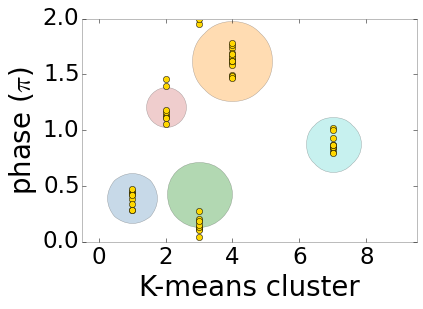

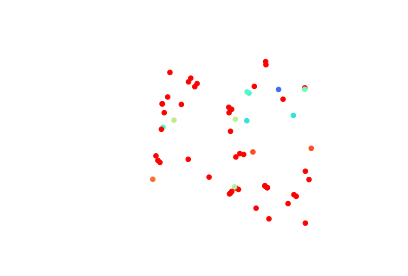

In [122]:
ax = pl.figure().add_subplot(111)
for i in set(phases[1][~np.isnan(phases[0])]):
    print (i)
    pl.plot(i, np.mean(phases[0][phases[1]==i]/np.pi), 
            'o', ms=sum(phases[1]==i)*5, alpha=0.3)
pl.plot(phases[1], phases[0]/np.pi, 'o')
ax.set_xlim(-0.5,9.5)
ax.set_xlabel("K-means cluster")
ax.set_ylabel(r"phase ($\pi$)")

ax = pl.figure().add_subplot(111)
cmap =  pl.cm.rainbow(phases[0][~np.isnan(phases[0])])
print (len(cmap), len(phases[0][~np.isnan(phases[0])]), cmap)

#cmap = cm.rainbow
#cs1 = [colors[i] for i in range(len(phases[0]))] 
#for p in range(len(phases[0])):
#    pl.scatter(phases[2][p], phases[3][p], color = cmap(len(phases[0]) / float(phases[0][p])))
pl.scatter(phases[2][~np.isnan(phases[0])], phases[3][~np.isnan(phases[0])], color = cmap)
ax.get_axes().set_aspect('equal', 'datalim')
ax.axis('off')